# Feature Importance

We have a model trained on a bunch of features.

Which of these features are actually important?

---


Some methods:

* SHAP feature importance. See e.g https://github.com/slundberg/shap

* Permutation feature importance. See e.g. https://christophm.github.io/interpretable-ml-book/feature-importance.html. 

* Drop column importance.
---

# 1. Permutation feature importance

We use permutation feature importance for now because it is easier and quicker.

See `scripts/feature_imporance.py` for the implementaion.

In [13]:
import pandas as pd

#Load the data
f = '/network/aopp/chaos/pred/kimpson/ML4L/scripts/small_data/feature_importance.pkl'
df = pd.read_pickle(f)

#Split loss/accuracy
df['loss'] = df['score'].apply(lambda x: x[0])
df['accuracy'] = df['score'].apply(lambda x: x[1])

#Get training loss of null hypothesis i.e. model with no permutations
target_value = df.query('feature == "H0"').loss.values[0]

#Create a normalised score w.r.t target value
#df['loss_normalized'] = df.loss/target_value
df['loss_normalized'] = df.loss - target_value
#Sort it
df = df.sort_values(by=['loss_normalized']).reset_index(drop=True)

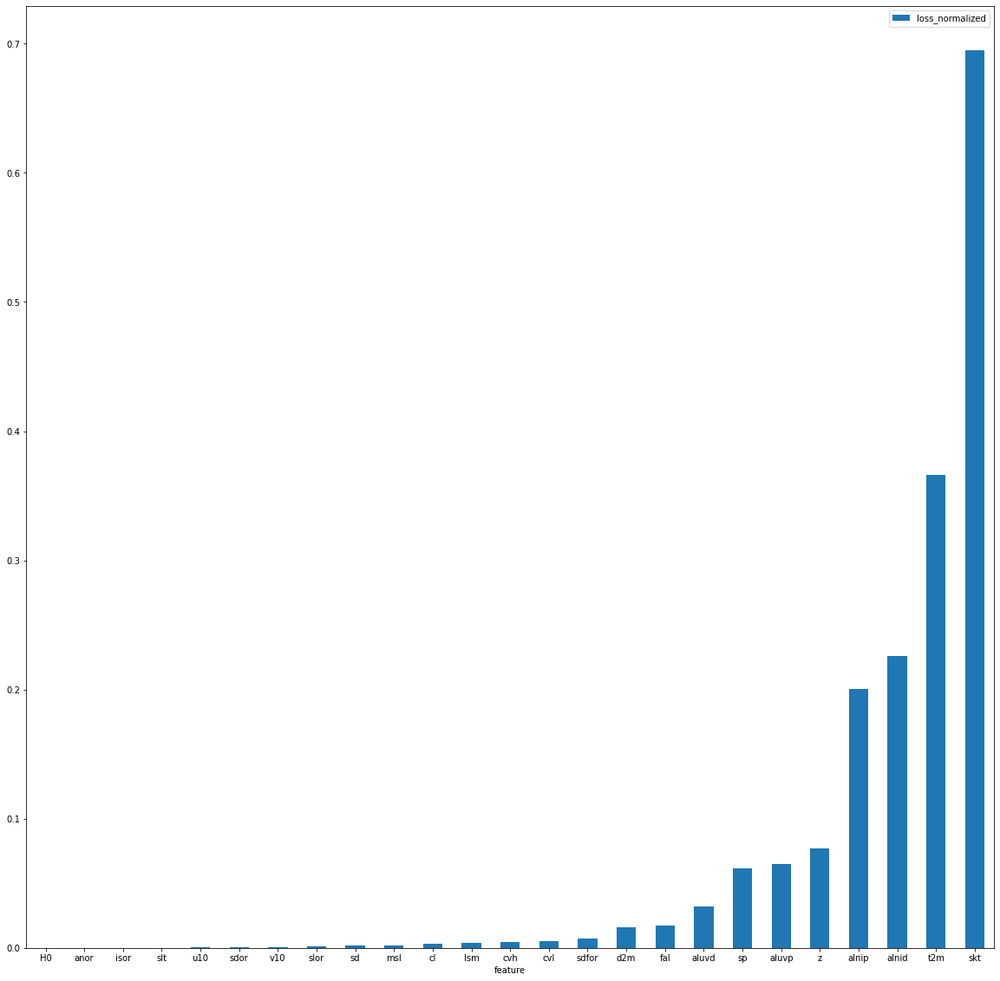

In [15]:
#Plot it
ax = df.plot.bar(x='feature', y='loss_normalized', rot=0,figsize=(20,20))

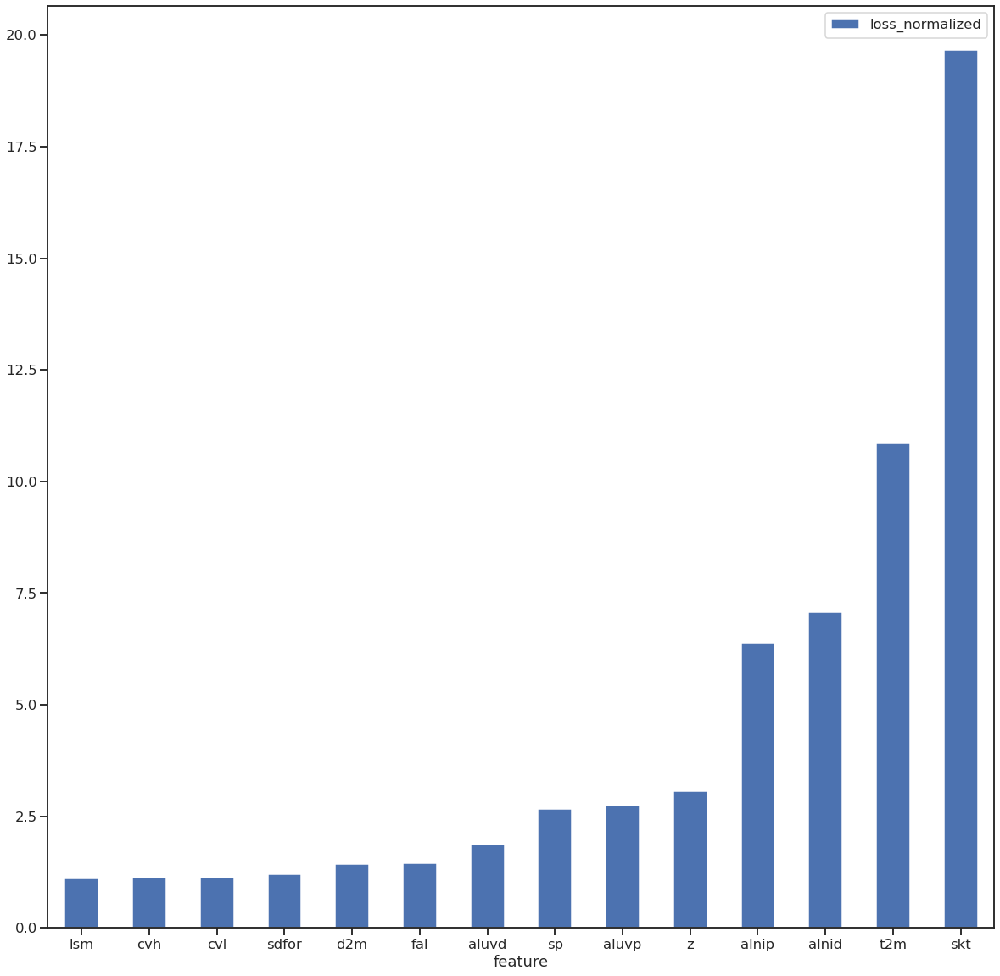

In [67]:
#Get rid of small vales
df_cropped = df.query('loss_normalized > 1.1')
ax = df_cropped.plot.bar(x='feature', y='loss_normalized', rot=0,figsize=(20,20))

# 2. Drop column importance


See `scripts/training_feature_importance.py`


The gist here is drop a feature, then train a model from scratch and make some predictions. We can then compare all of these models/predictions against the "full model".


In [51]:
   
#Load data into dfs
import pandas as pd
def load_and_errors(path):
    
    parameter = path.split('ML_FI_')[-1]
    print('Parameter:', parameter)
 
    df = pd.read_pickle(path+'predictions.pkl')
    df['error'] = df.MODIS_LST - df.predictions
    df['error_abs'] = abs(df.MODIS_LST - df.predictions)
    df['parameter'] = parameter
    
   
    return df 


In [52]:
import glob
all_paths = glob.glob('/network/group/aopp/predict/TIP016_PAXTON_RPSPEEDY/ML4L/ML_FI_*/')

dfs = []   # To hold all data

for p in all_paths:
    df = load_and_errors(p)
    dfs.append(df)

Parameter: H0/
Parameter: sp/
Parameter: msl/
Parameter: u10/
Parameter: v10/
Parameter: t2m/
Parameter: aluvp/
Parameter: aluvd/
Parameter: alnip/
Parameter: alnid/
Parameter: cl/
Parameter: cvl/
Parameter: cvh/
Parameter: slt/
Parameter: sdfor/
Parameter: z/
Parameter: sd/
Parameter: sdor/
Parameter: isor/
Parameter: anor/
Parameter: slor/
Parameter: d2m/
Parameter: lsm/
Parameter: fal/
Parameter: skt/


In [53]:
#Now we have all the dfs, lets get the mean absolute error for each
xdata = []
ydata = []

for df in dfs:
    
    parameter_name = df.parameter.values[0]
    mean_error = df.error_abs.mean()
    
    xdata.extend([parameter_name])
    ydata.extend([mean_error])
    
df_mean_error = pd.DataFrame(data={'parameter':xdata, 'error':ydata})

In [54]:
#And we can plot it

#Get training loss of null hypothesis i.e. model with no permutations
target_value = df_mean_error.query('parameter == "H0/"').error.values[0]

# #Create a normalised score w.r.t target value
df_mean_error['error_normalized'] = df_mean_error.error - target_value

# #Sort it
df_mean_error = df_mean_error.sort_values(by=['error_normalized']).reset_index(drop=True)

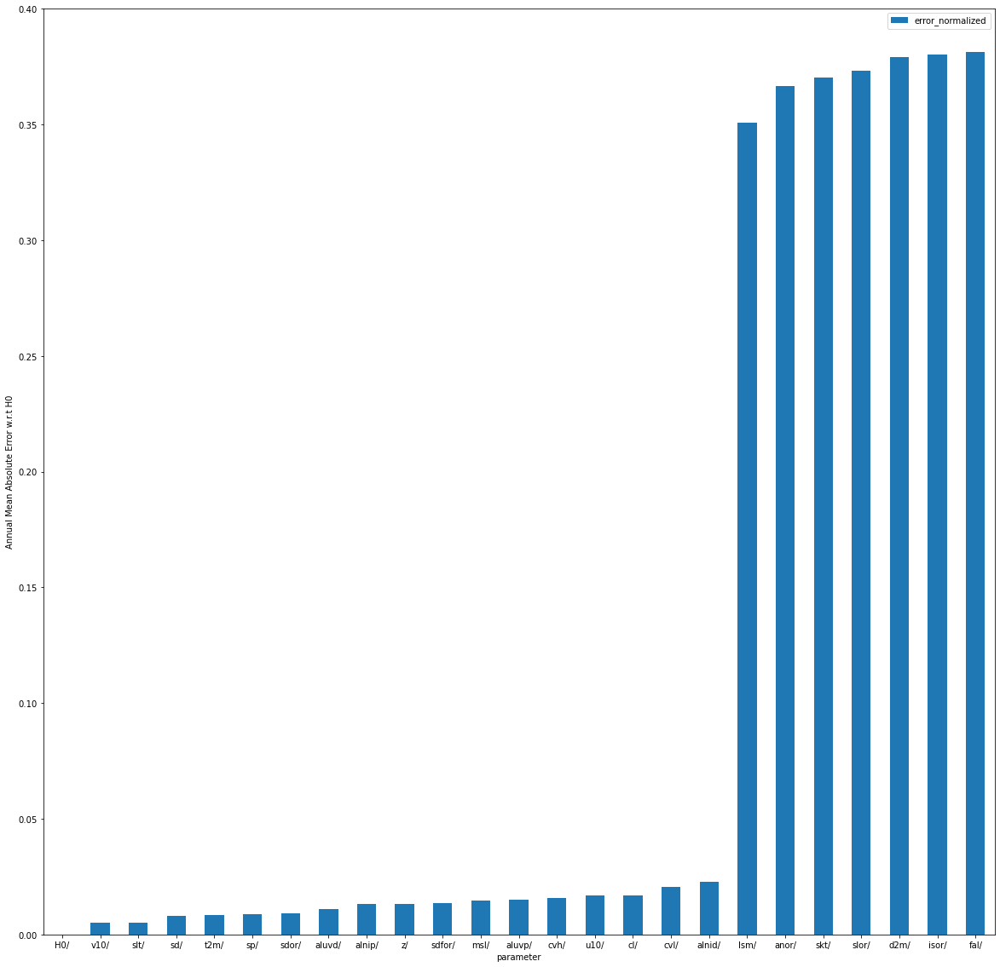

In [57]:
ax = df_mean_error.plot.bar(x='parameter', y='error_normalized', 
                            rot=0,figsize=(20,20),
                            ylabel='Annual Mean Absolute Error w.r.t H0')

There are clearly some parameters which cause large differences in the model:

```
lsm, anor, skt, slor, d2m, isor, fal
```




In [60]:
import requests
r = requests.get("https://apps.ecmwf.int/codes/grib/json/").json()['parameters']

def param_name(x,r):
    try:
        d = next(item for item in r if item["param_shortName"] == x)
        name = d['param_name']
        units = d['units_name']
    except:
        #maybe naming convention is different
        name = 'Unknown'
        units = 'Unknown'
    
    return f'{x}: {name} : {units}'

important_features = ['lsm', 'anor','skt','slor','2d','isor', 'fal'] #d2m = 2d
for i in important_features:
    print(param_name(i,r))

lsm: Land-sea mask : (0 - 1)
anor: Angle of sub-gridscale orography : radians
skt: Skin temperature : K
slor: Slope of sub-gridscale orography : ~
2d: 2 metre dewpoint temperature : K
isor: Anisotropy of sub-gridscale orography : ~
fal: Forecast albedo : (0 - 1)


It could also be useful to look at this geograpjhically. Lets group over the year and plot

In [61]:
grouped_dfs = []
for df in dfs:
    
    parameter = df.parameter.values[0]
    print(parameter)
    
    grouped_df = df.groupby(['latitude_ERA', 'longitude_ERA'],as_index=False).mean()
    grouped_df['parameter'] = parameter
    grouped_dfs.append(grouped_df)

H0/
sp/
msl/
u10/
v10/
t2m/
aluvp/
aluvd/
alnip/
alnid/
cl/
cvl/
cvh/
slt/
sdfor/
z/
sd/
sdor/
isor/
anor/
slor/
d2m/
lsm/
fal/
skt/


In [ ]:
        
import matplotlib.colors as mc
import matplotlib.colorbar as cb 
import matplotlib.pyplot as plt
def plot_map(df,z,vmin,vmax,cmap,title):
    
    #Get all data as vectors
    x = df.longitude_ERA
    y = df.latitude_ERA
    z1 = df[z]
    
    #Scatter plot it
    # init the figure
    fig,[ax,cax] = plt.subplots(1,2, gridspec_kw={"width_ratios":[50,1]},figsize=(30, 20))

    
    norm = mc.Normalize(vmin=vmin, vmax=vmax)

    cb1 = cb.ColorbarBase(cax, cmap=cmap,
                                norm=norm,
                                orientation='vertical')
    
    
    sc = ax.scatter(x, y,
               s=1,
               c=cmap(norm(z1)),
               linewidths=1, alpha=.7
               )

    ax.set_title(title)
    

    plt.show()

1 sp/


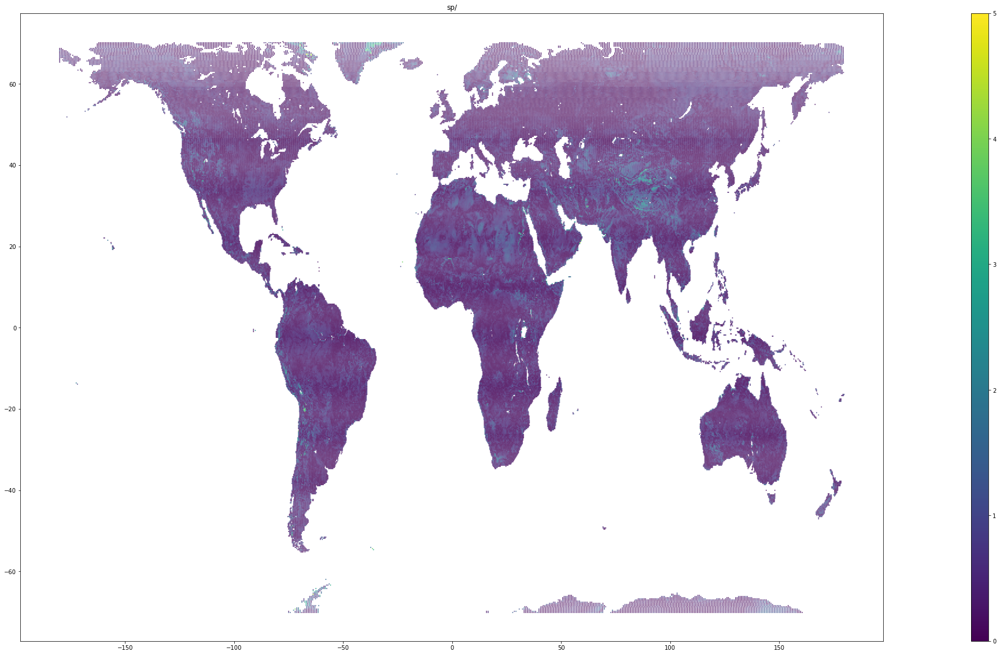

2 msl/


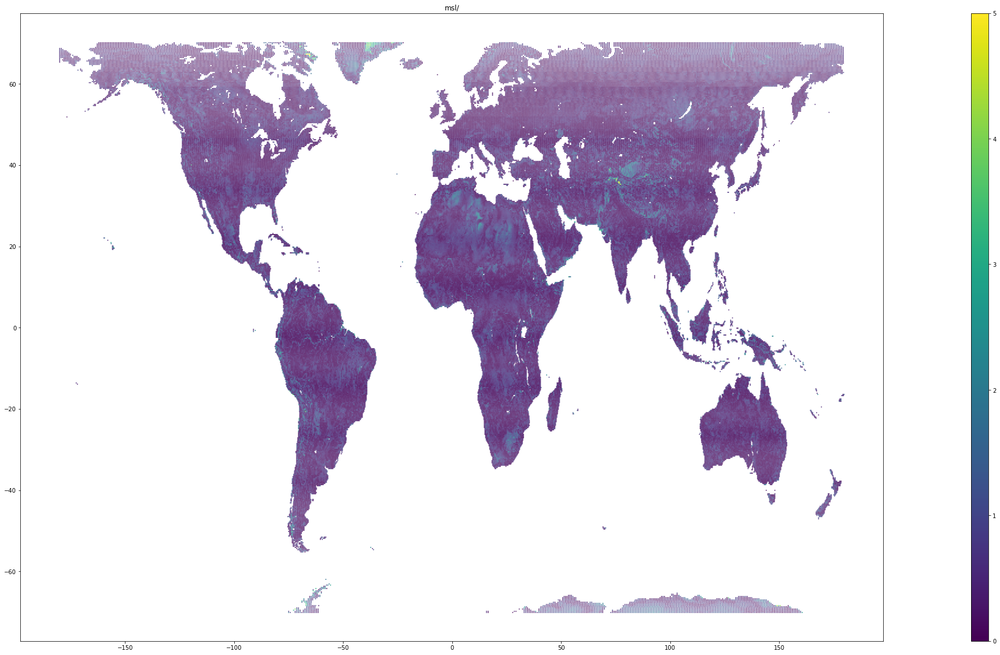

3 u10/


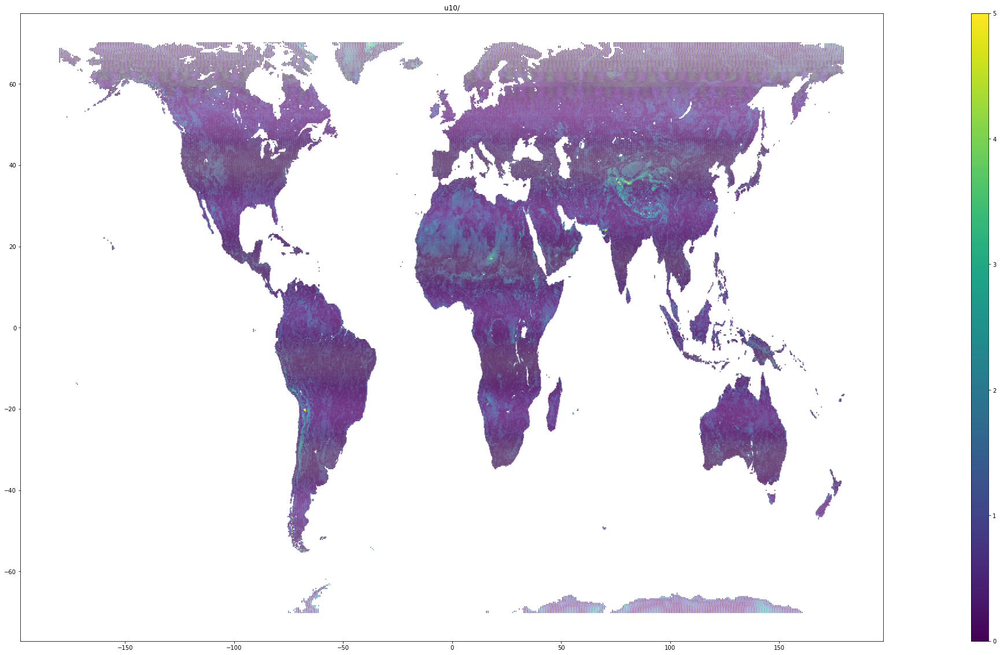

4 v10/


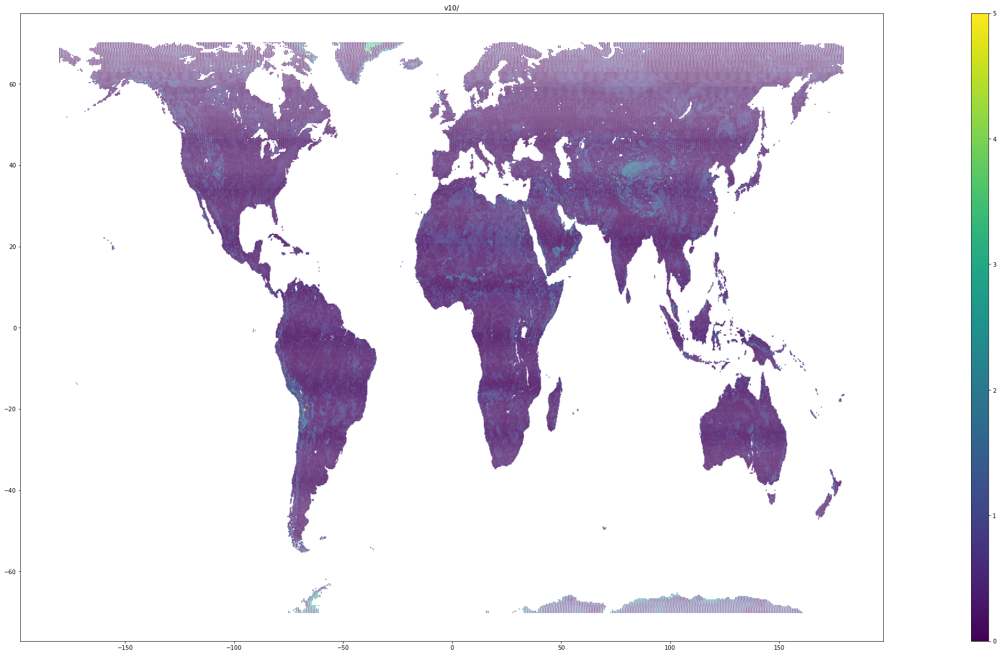

5 t2m/


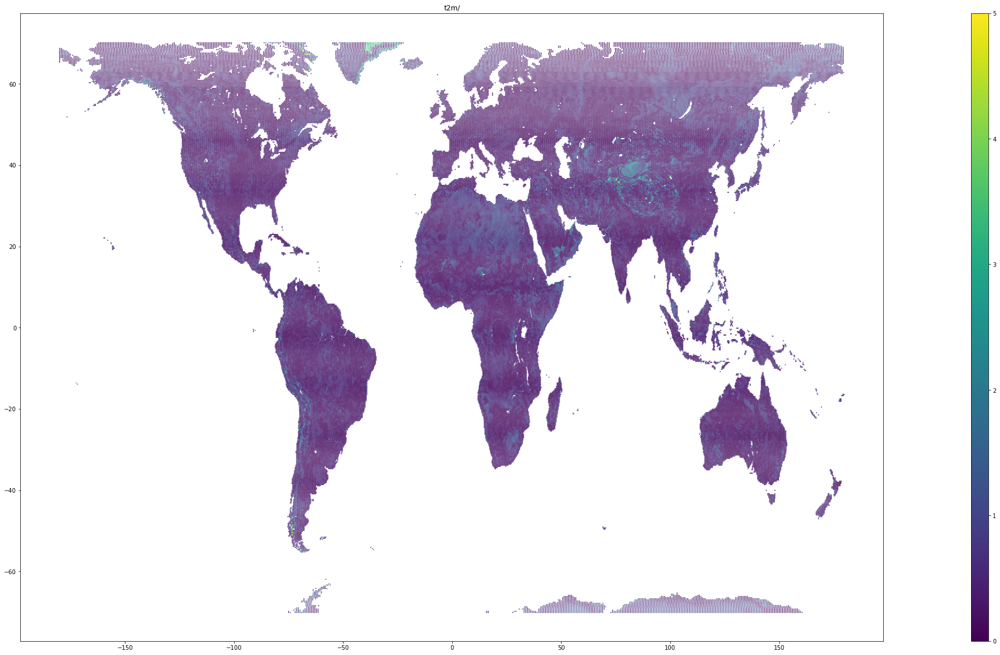

6 aluvp/


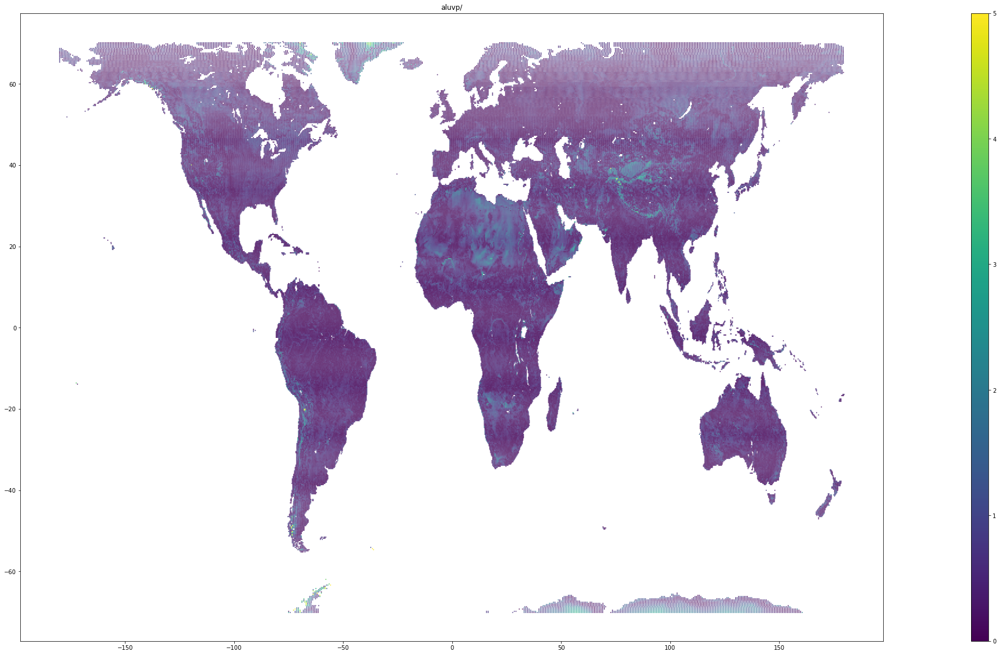

7 aluvd/


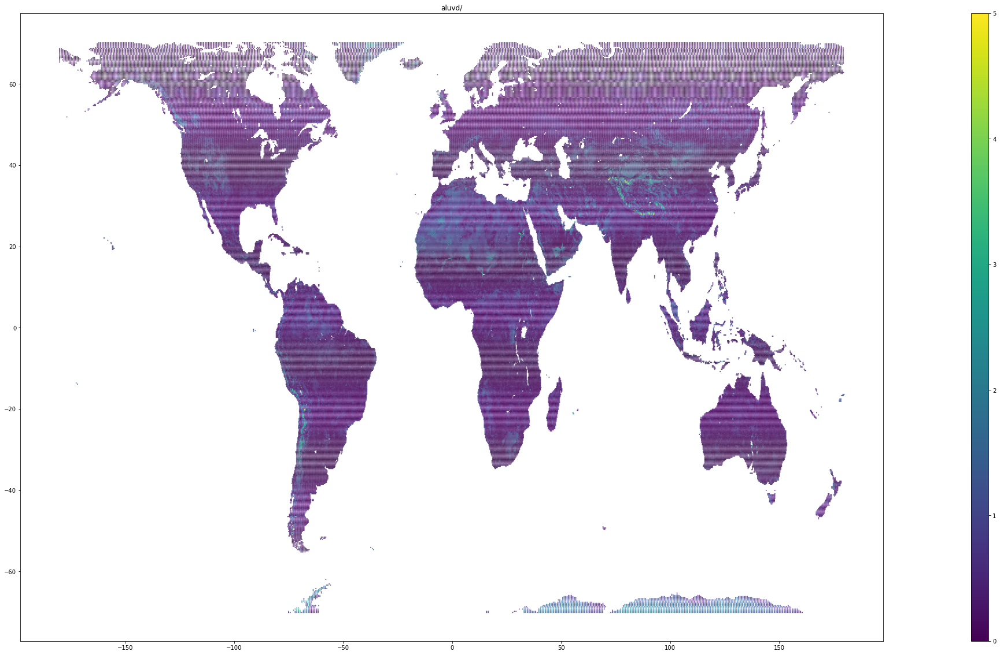

8 alnip/


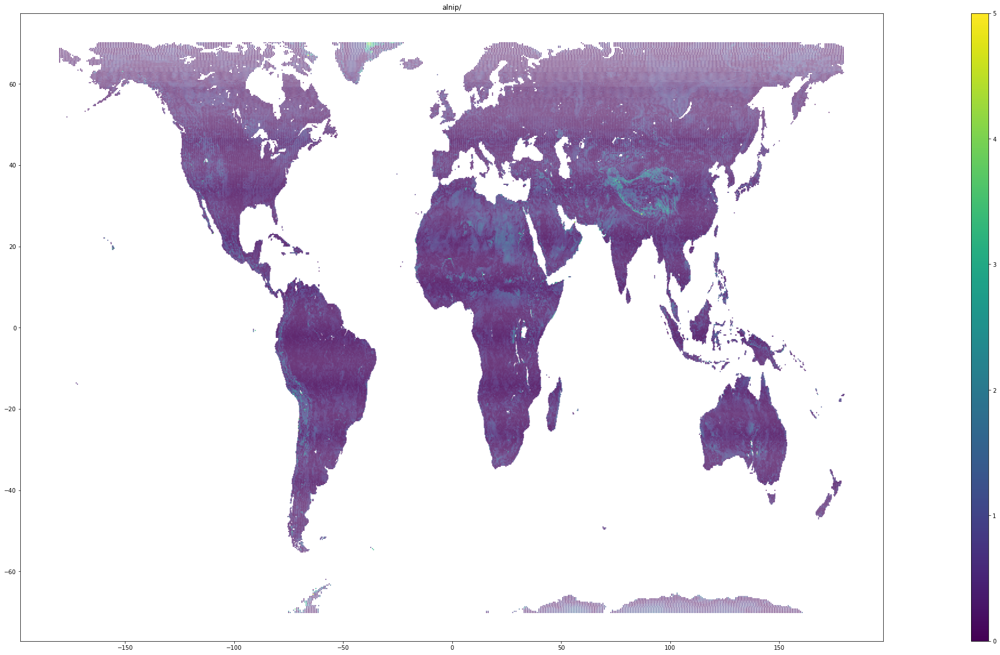

9 alnid/


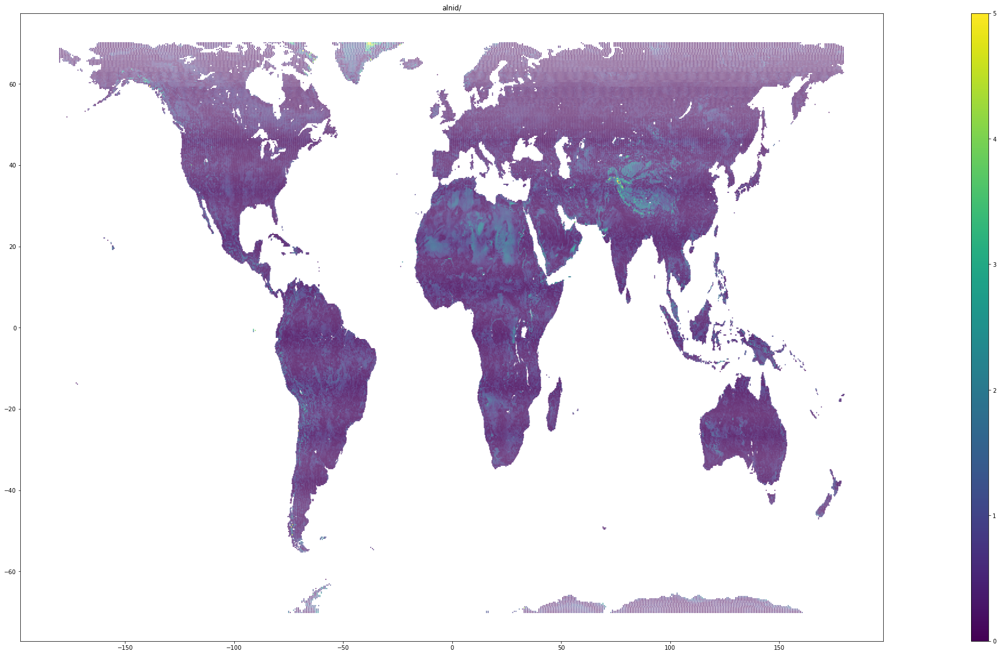

10 cl/


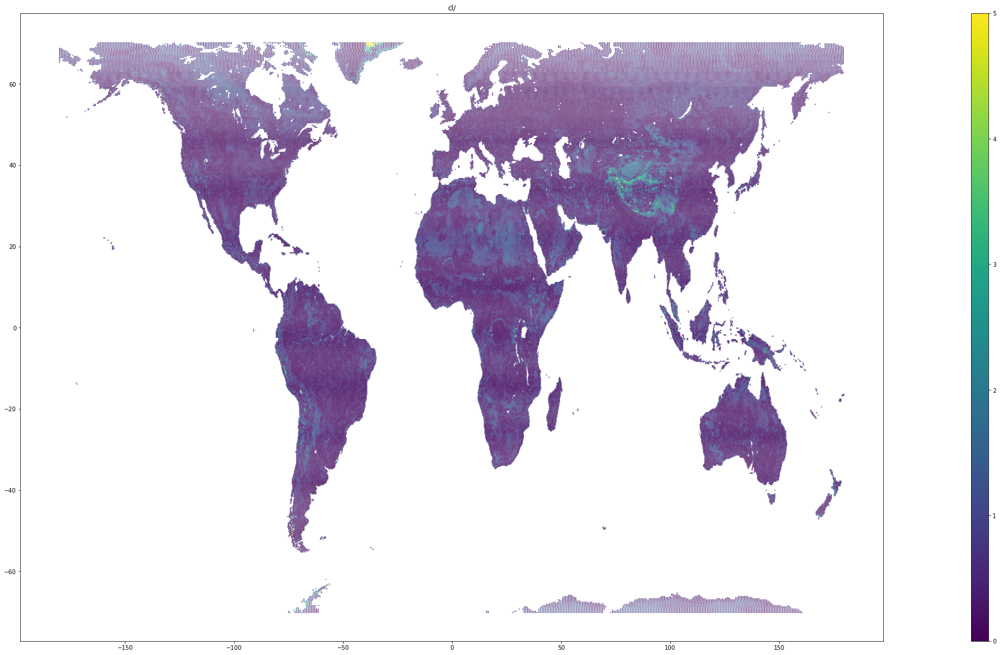

11 cvl/


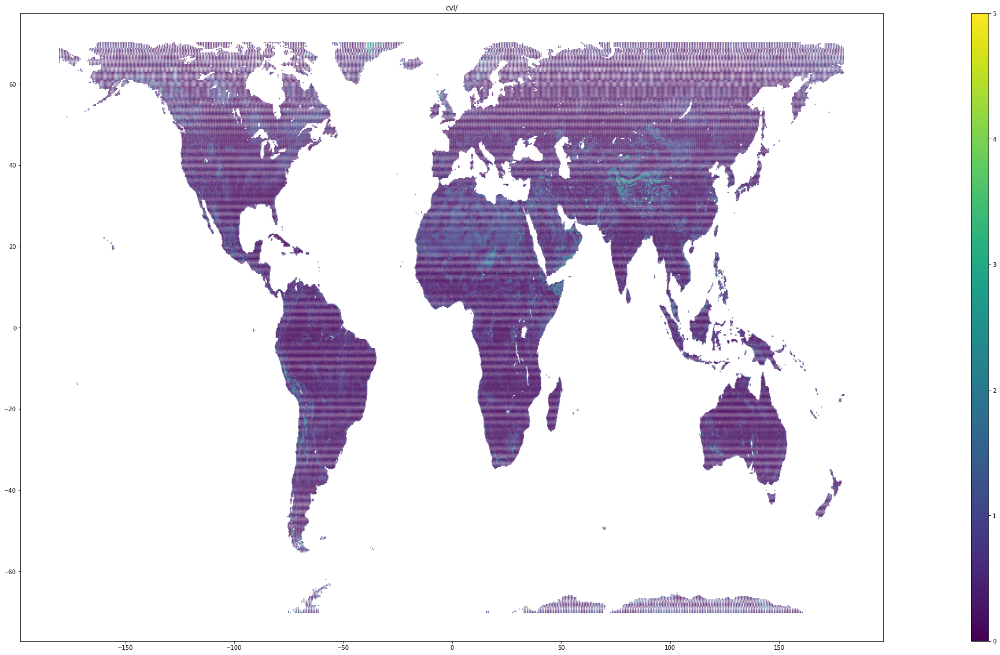

12 cvh/


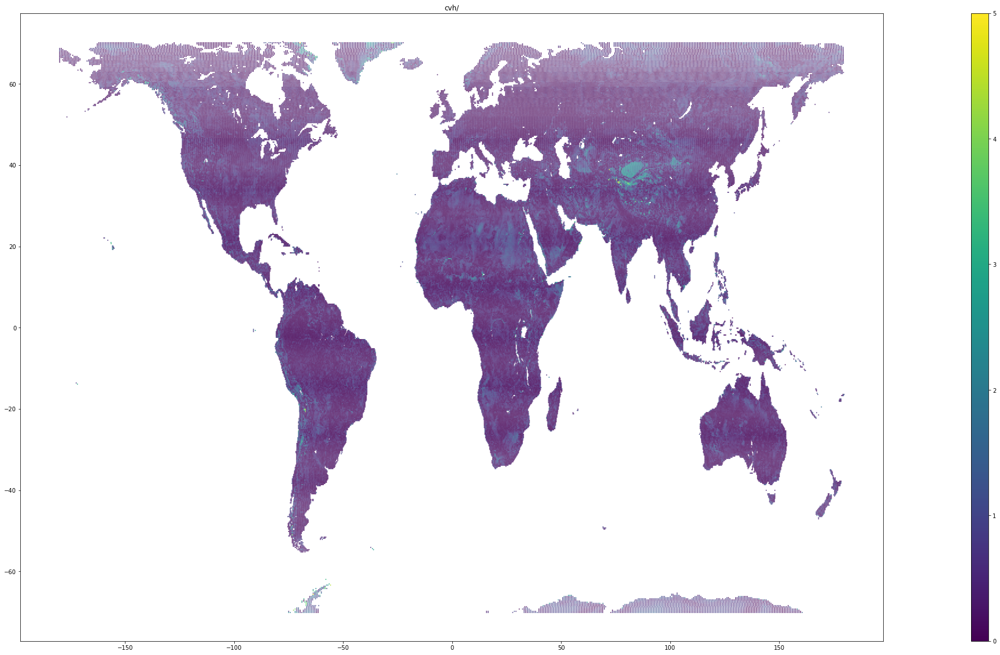

13 slt/


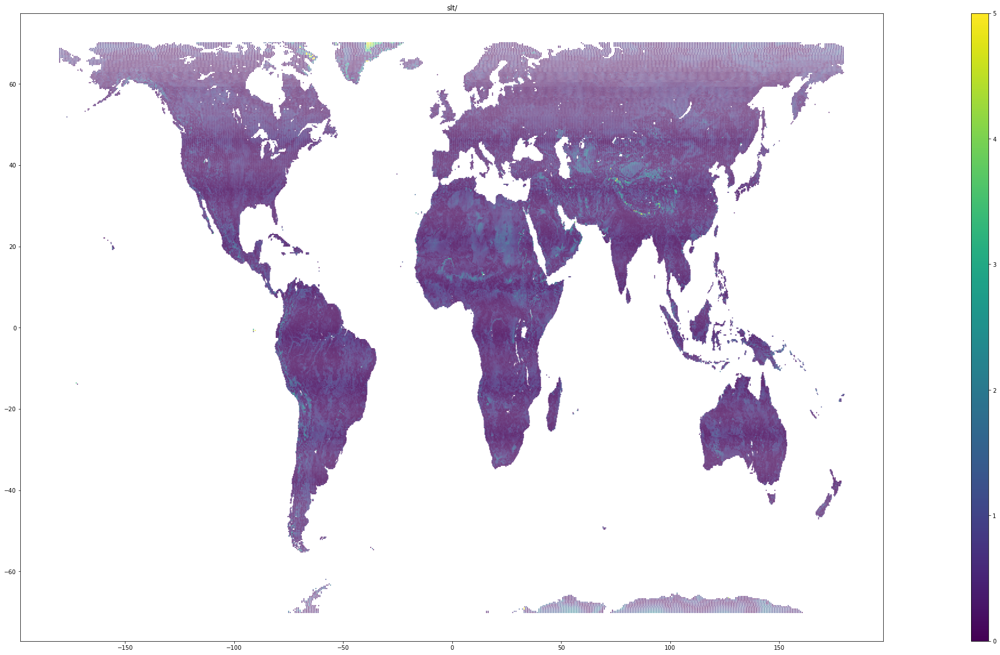

14 sdfor/


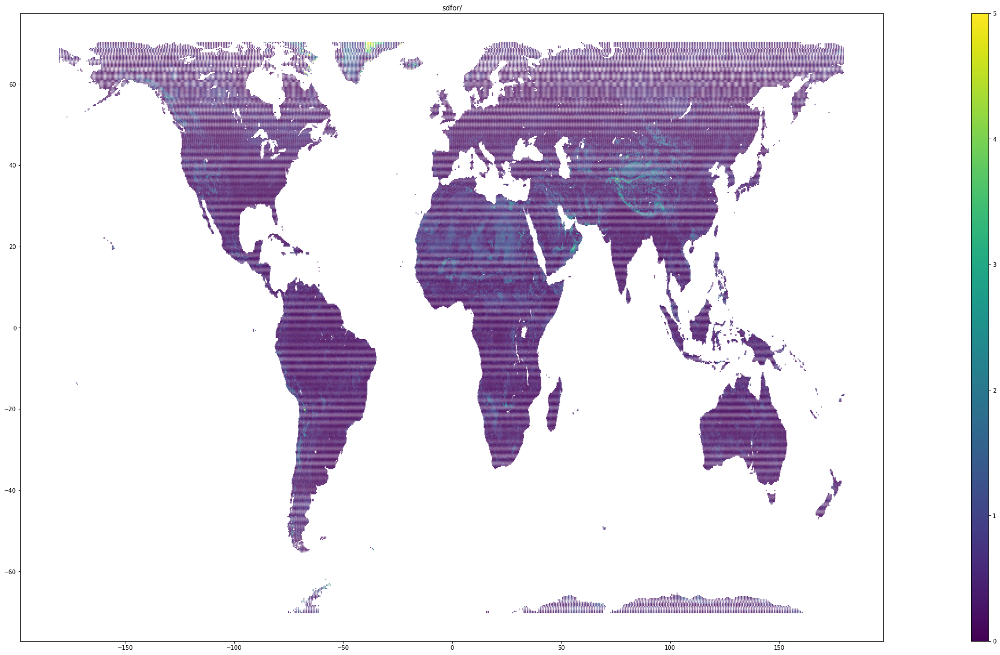

15 z/


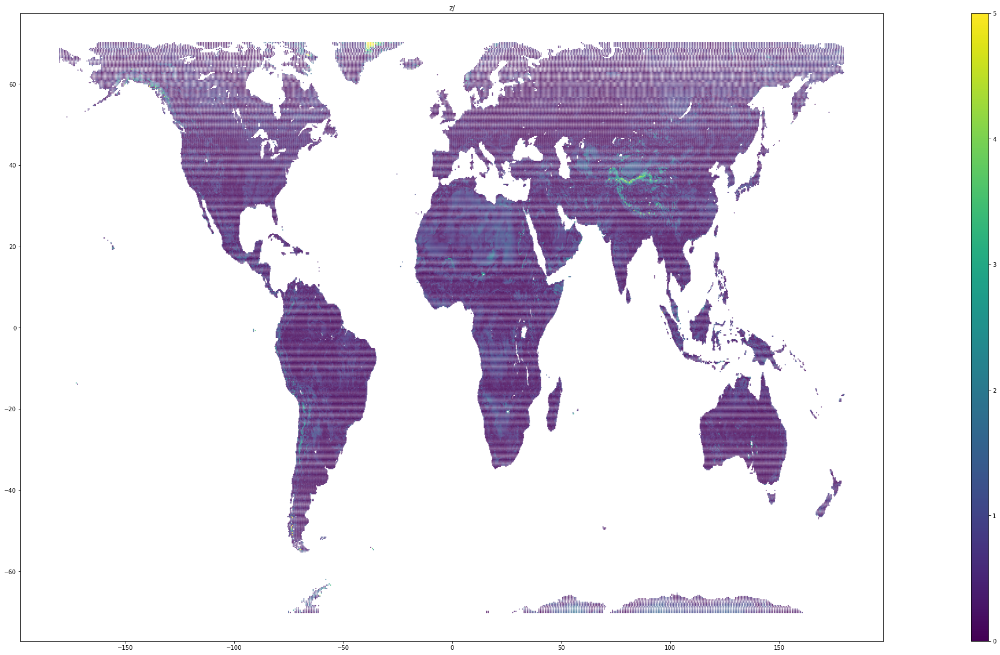

16 sd/


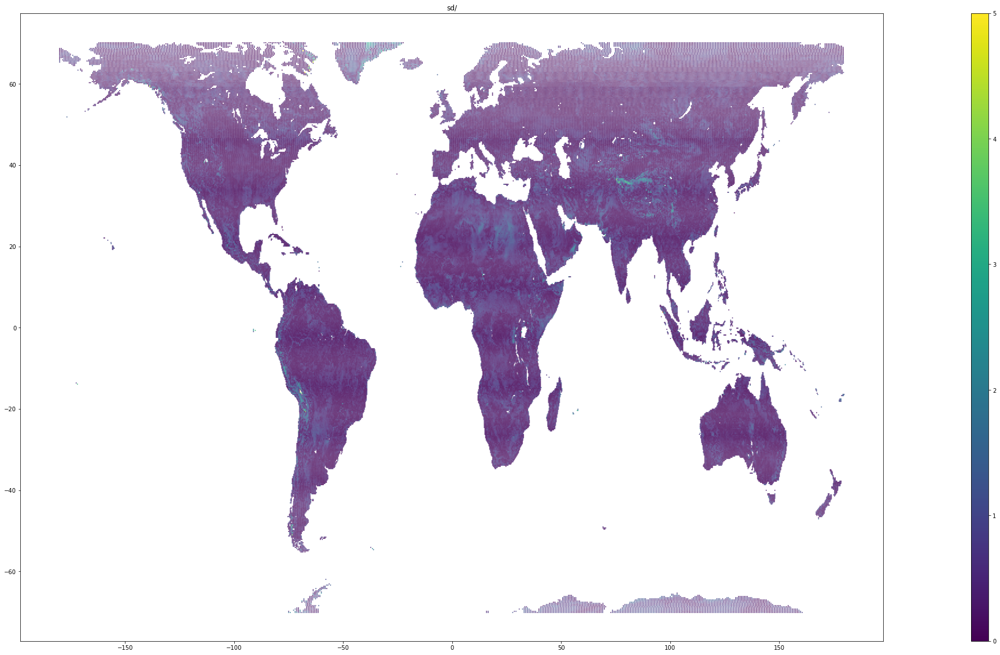

17 sdor/


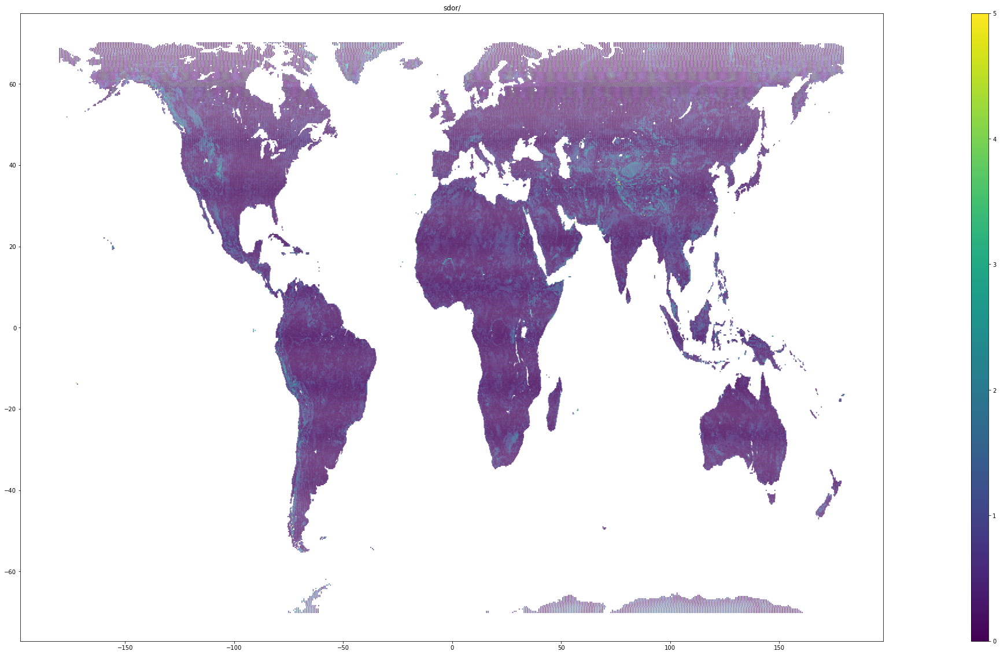

18 isor/


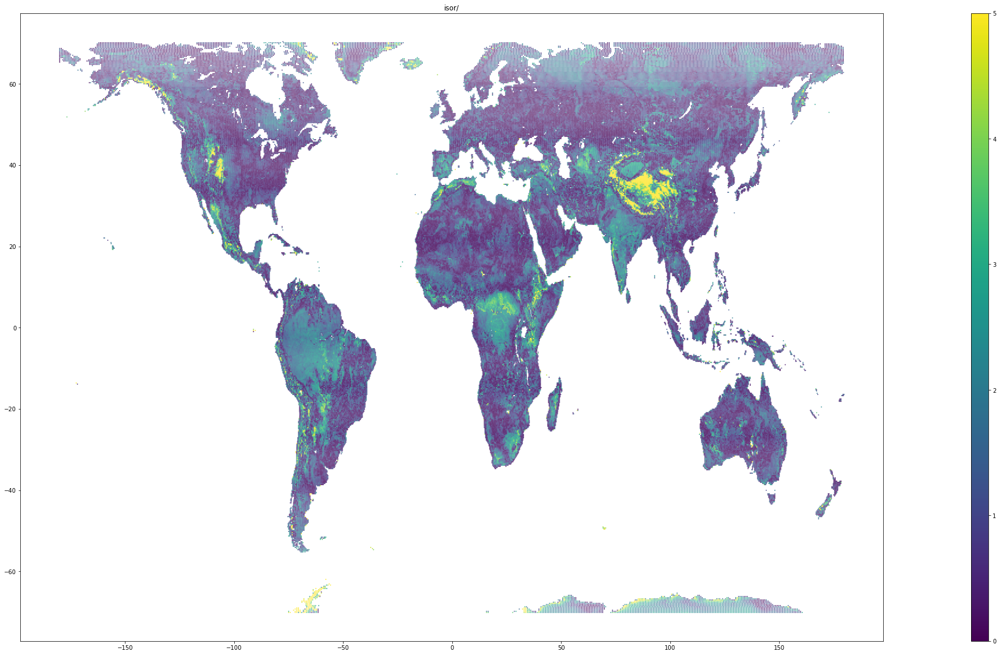

19 anor/


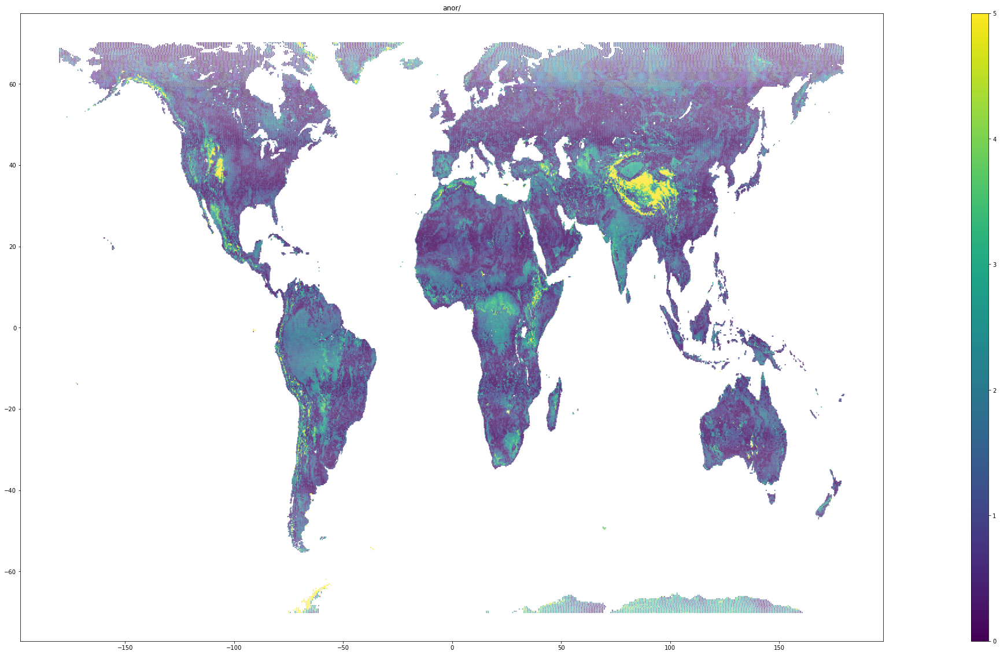

20 slor/


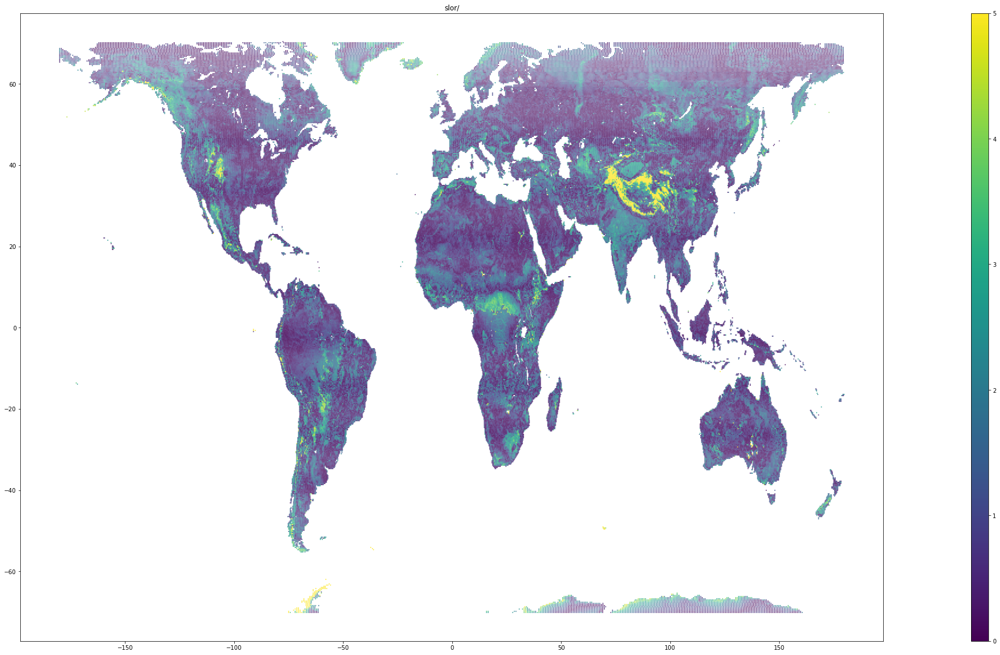

21 d2m/


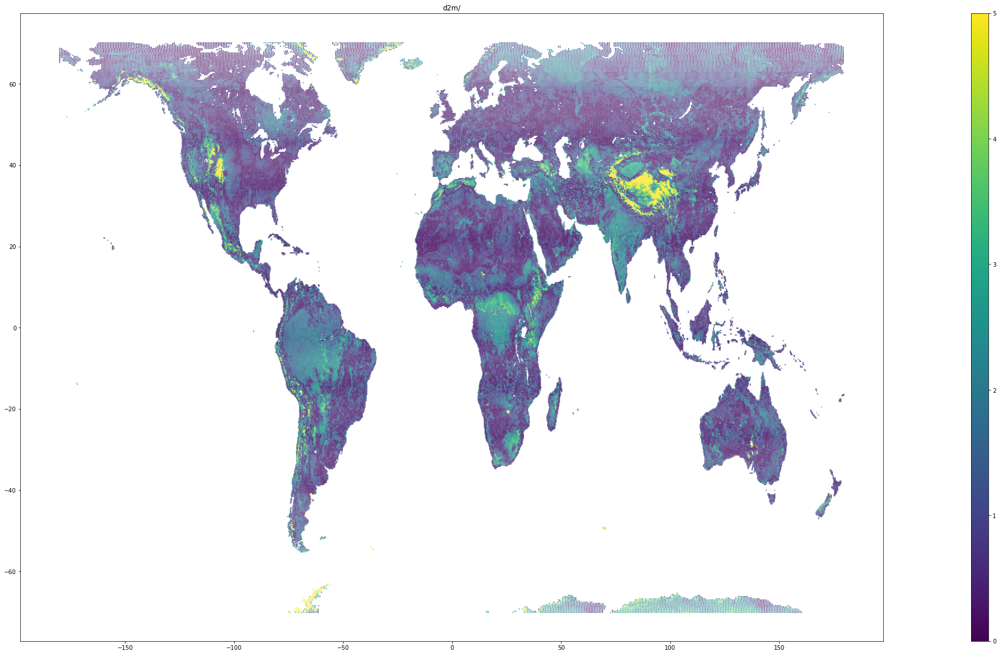

22 lsm/


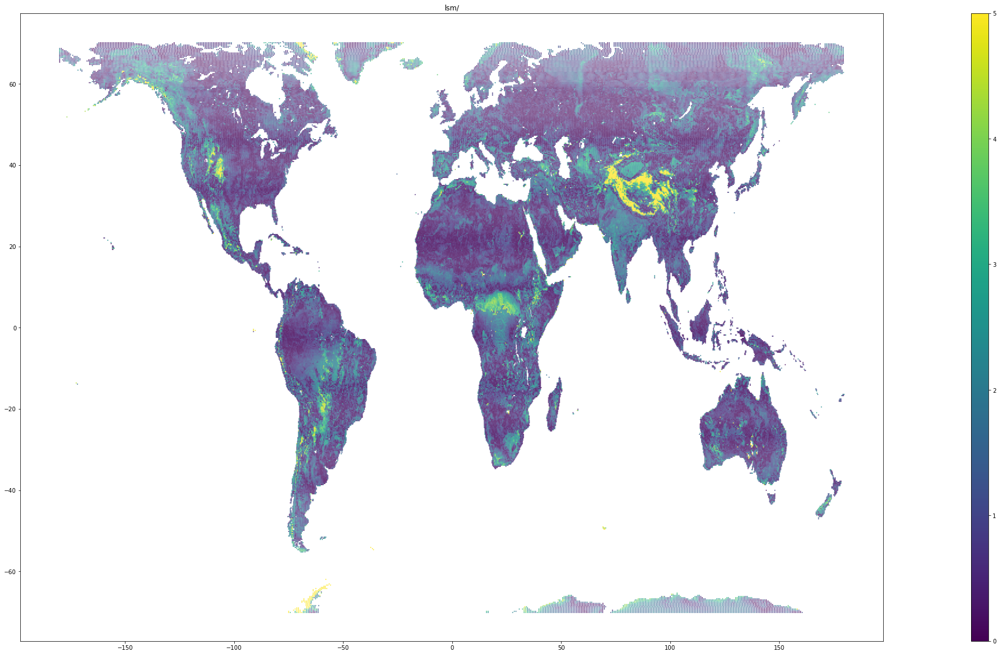

23 fal/


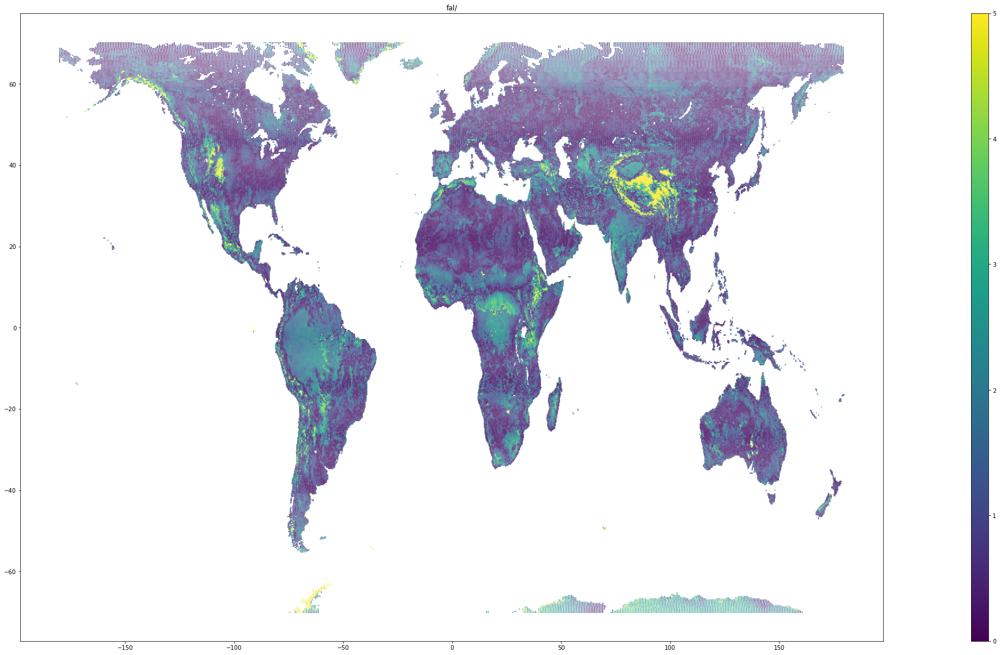

24 skt/


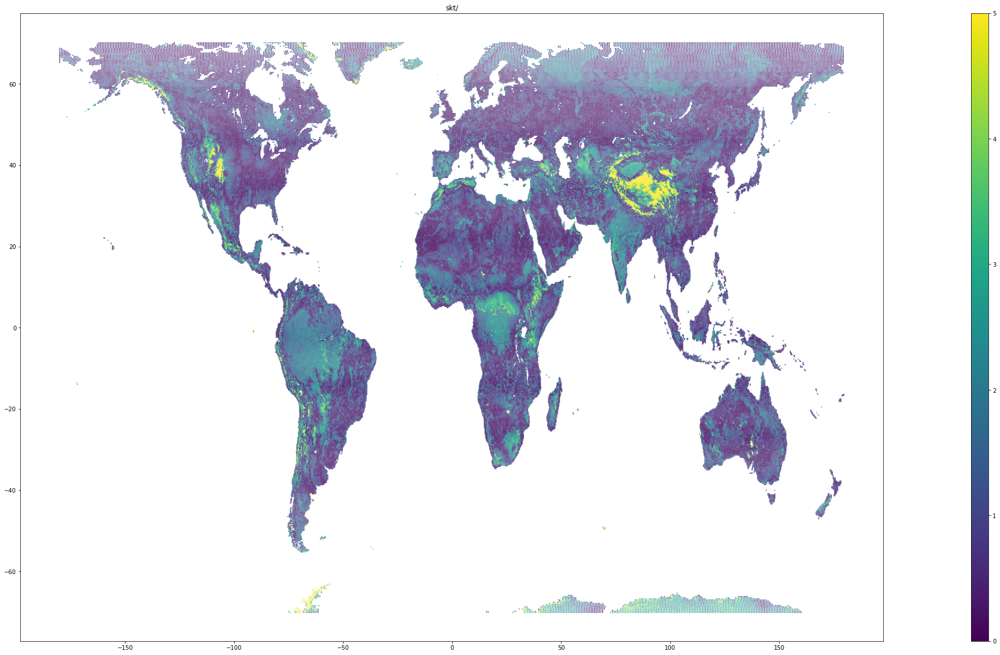

In [50]:
for i in range(1,len(grouped_dfs)):
    
    df = grouped_dfs[i]
    parameter = df.parameter.values[0]
    print(i,parameter)
    df['delta'] = abs(df.predictions - base_df.predictions)
    plot_map(df,'delta',vmin=0,vmax=5,cmap = plt.cm.viridis,title=parameter)


# 3. Relation to reverse problem




In `07. Reverse_learning.ipynb` we look at the MODIS--->ERA problem, using a subset (constant) of all features.

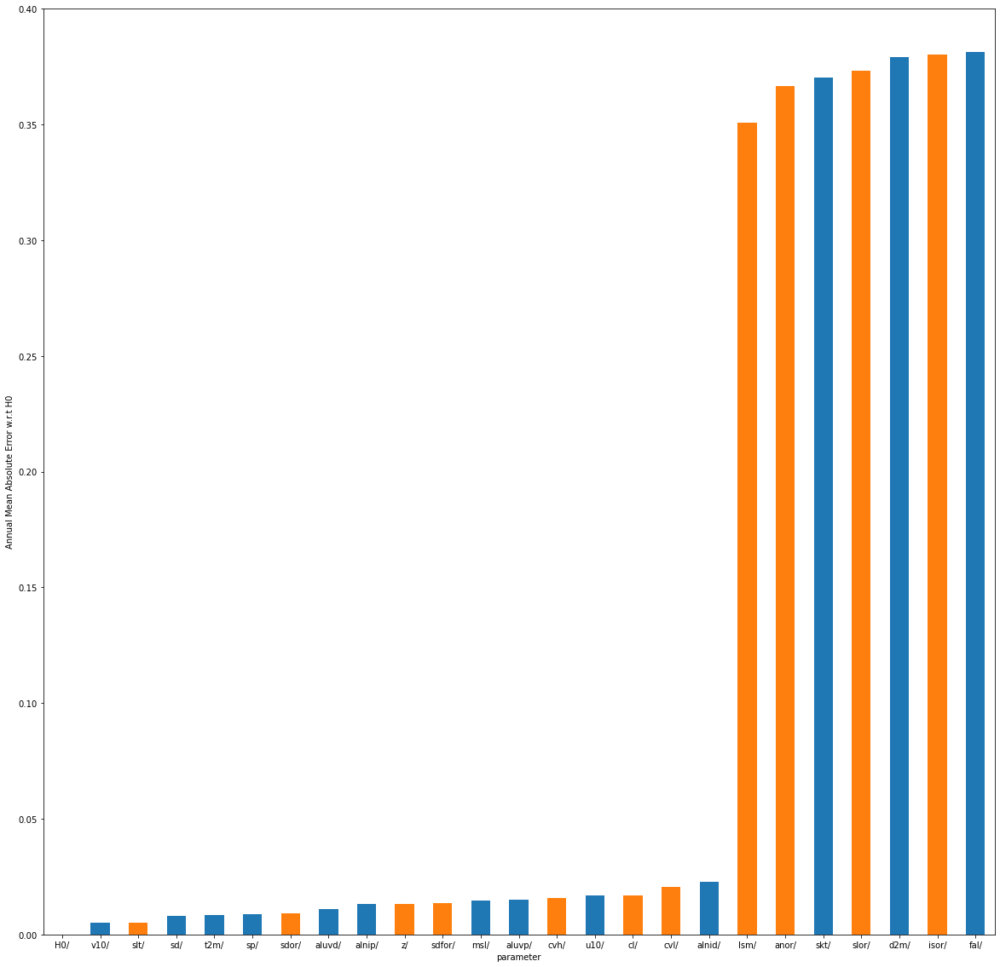

In [68]:
constant_features = ['anor/', 'cl/', 'cvh/', 'cvl/', 'isor/', 'lsm/', 'sdfor/', 'sdor/', 'slor/','slt/', 'z/']


pos = df_mean_error.index[df_mean_error['parameter'].isin(constant_features)].tolist()

ax = df_mean_error.plot.bar(x='parameter', y='error_normalized', 
                            rot=0,figsize=(20,20),
                            ylabel='Annual Mean Absolute Error w.r.t H0',legend = None)
for i in pos:
    ax.patches[i].set_facecolor('C1')
plt.show()

Interestingly a lot of the constant features are the most useful